# Data Structures: `Map` and `Timeseries`

In [3]:
import copy
import glob

import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
from IPython.display import HTML

import astropy.table
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.visualization import AsymmetricPercentileInterval, ImageNormalize, LogStretch

import sunpy.map
import sunpy.timeseries
import sunpy.sun.constants
from sunpy.coordinates import Helioprojective

## The `Map` Data Structure

In [4]:
aia_files = sorted(glob.glob('data/AIA/*.fits'))
stereo_files = sorted(glob.glob('data/SECCHI/*.fts'))

We create a `sunpy.map.Map` object by passing in the FITS file for a single AIA and SECCHI (STEREO) observation.
We've purposefully chosen an observation after the eruption started.

In [5]:
m_aia = sunpy.map.Map(aia_files[6])
m_stereo = sunpy.map.Map(stereo_files[6])

We can easily visualize a map after loading it using the quicklook functionality.

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


Observatory,STEREO A
Instrument,SECCHI
Detector,EUVI
Measurement,304.0 Angstrom
Wavelength,304.0 Angstrom
Observation Date,2022-03-28 11:30:45
Exposure Time,4.00208 s
Dimension,[2048. 2048.] pix
Coordinate System,helioprojective
Scale,[1.58777404 1.58777404] arcsec / pix
Reference Pixel,[1024.62 1124.74] pix

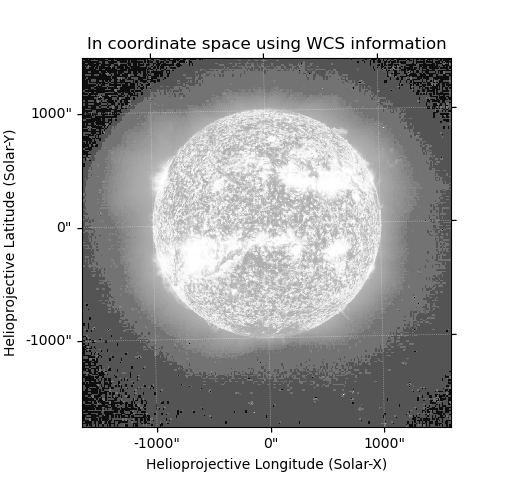
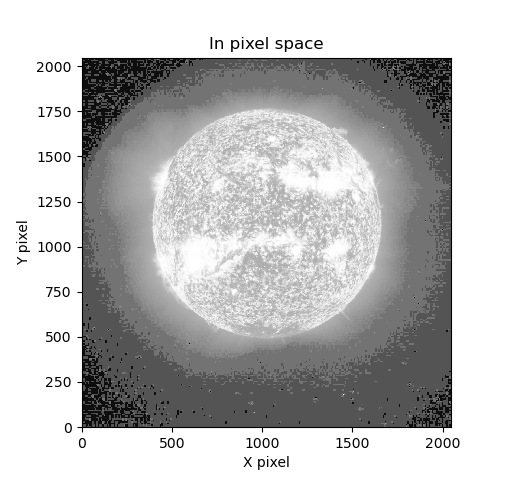
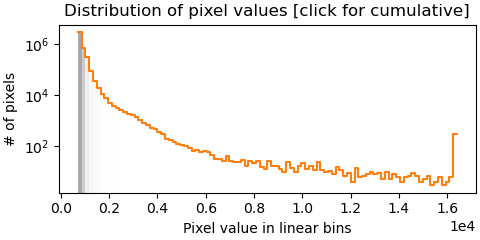
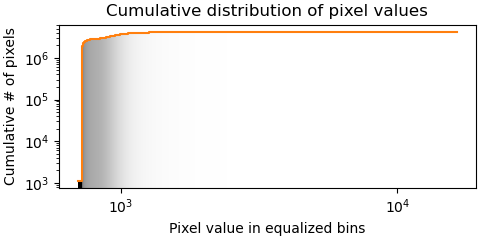

In [6]:
m_stereo

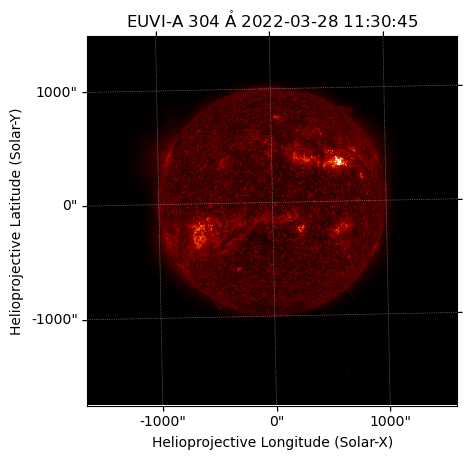

In [7]:
m_stereo.plot()

We will talk much more about the `plot` command in later sections.

### Attributes of `Map`

`Map` provides a common interface to most 2D imaging solar datasets and provides several useful pieces of metadata.
As mentioned in the intro slide, `Map` is a container for holding your data and metadata (usually from the FITS header) together.

The `.meta` and `.data` attributes provide access to the metadata and underlying array of image data, respectively.

In [8]:
m_aia.data

array([[ 1, -1,  0, ..., -1,  1,  1],
       [ 1, -1, -2, ..., -1, -1,  2],
       [ 1, -1, -1, ...,  1,  0,  0],
       ...,
       [-1,  0, -1, ..., -1,  2, -2],
       [-1,  0,  1, ..., -1,  3,  1],
       [-2,  1,  1, ...,  0, -1, -2]], dtype=int16)

In [9]:
m_aia.meta

MetaDict([('xtension', 'IMAGE'),
          ('bitpix', 16),
          ('naxis', 2),
          ('naxis1', 4096),
          ('naxis2', 4096),
          ('pcount', 0),
          ('gcount', 1),
          ('bld_vers', 'V9R41X'),
          ('lvl_num', 1.0),
          ('t_rec', '2022-03-28T11:30:07Z'),
          ('trecstep', 1.0),
          ('trecepoc', '1977.01.01_00:00:00_TAI'),
          ('trecroun', 1),
          ('origin', 'SDO/JSOC-SDP'),
          ('date', '2022-04-01T06:07:24'),
          ('telescop', 'SDO/AIA'),
          ('instrume', 'AIA_4'),
          ('date-obs', '2022-03-28T11:30:05.15'),
          ('t_obs', '2022-03-28T11:30:06.60Z'),
          ('camera', 4),
          ('img_type', 'LIGHT'),
          ('exptime', 2.90206),
          ('expsdev', 0.000202),
          ('int_time', 3.148438),
          ('wavelnth', 304),
          ('waveunit', 'angstrom'),
          ('wave_str', '304_THIN'),
          ('fsn', 253115839),
          ('fid', 0),
          ('quallev0', 0),
          ('q

However, this metadata can be terse, non-homogeneous, and sometimes difficult to parse.
`Map` provides several attributes derived from the underlying raw metadata that expose a uniform interface to the metadata for each map.

In [10]:
m_aia.wavelength

<Quantity 304. Angstrom>

In [11]:
m_aia.rsun_meters

<Quantity 6.96e+08 m>

In [12]:
m_aia.rsun_obs

<Quantity 961.41438 arcsec>

In [13]:
m_stereo.instrument

'SECCHI'

Each `Map` object also holds the unit system that the image data is in, expressed in terms of an `astropy.unit.Unit` object.

### Coordinate Information

Each `Map` also exposes information about which coordinate system the image was taken in, including the location of the spacecraft that recorded that observation.

`sunpy` leverages and extends the powerful `astropy` coordinate framework that we heard about in the previous tutorial.
Additionally, we'll talk more about the `sunpy.coordinates` subpackage in the next notebook and show some neat examples.

For each `Map`, we can easily access what *coordinate frame* the observation cooresponds to.

In [14]:
m_aia.coordinate_frame

<Helioprojective Frame (obstime=2022-03-28T11:30:05.150, rsun=696000.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2022-03-28T11:30:05.150, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (0.01124165, -6.72365584, 1.49322527e+11)>)>

Similarly, we can look at the location of the observer (as defined by the position of the satellite at the time of the observation).

In [15]:
m_aia.observer_coordinate

<SkyCoord (HeliographicStonyhurst: obstime=2022-03-28T11:30:05.150, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (0.01124165, -6.72365584, 1.49322527e+11)>

In [16]:
m_stereo.observer_coordinate

<SkyCoord (HeliographicStonyhurst: obstime=2022-03-28T11:30:45.011, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, m)
    (-33.25158354, -7.21919964, 1.44615308e+11)>

We can plot these observer coordinates to show the relative position, in heliographic longitude, of each spacecraft, similar to the SolarMACH plot we showed in our previous notebook.

(**NOTE:** *It is not particuarly important to understand the intricacies of the plotting code below. This is merely to show we can use the coordination information in each map to visualize the relative positions of the three spacecraft we are concerned with here.*)

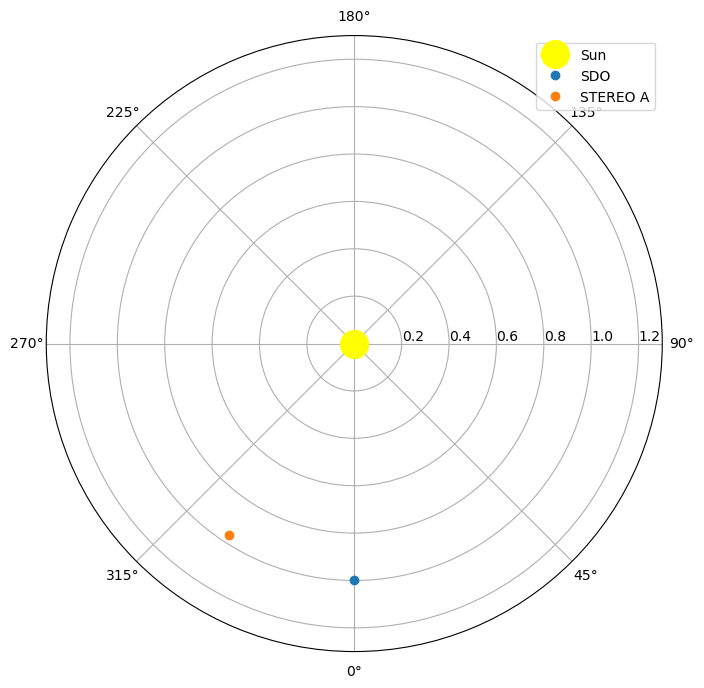

In [17]:
fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(projection='polar')

# Plot the Sun
ax.plot(0, 0, marker='o', markersize=20, label='Sun', color='yellow')

# Plot the satellite locations
for m in [m_aia, m_stereo]:
    sat = m.observatory
    coord = m.observer_coordinate
    ax.plot(coord.lon.to('rad'), coord.radius.to(u.AU), 'o', label=sat)

ax.set_theta_zero_location("S")
ax.set_rlabel_position(90)
ax.set_rlim(0, 1.3)
ax.legend()

### Visualization

In the astropy tutorial, we learned about how to create axes with projections derived from a particular WCS.
`Map` provides some additional "helpers" for plotting the associated image data with the correct projection based on the WCS.

At a minimum, this can be accomplished through the `.plot()` method.

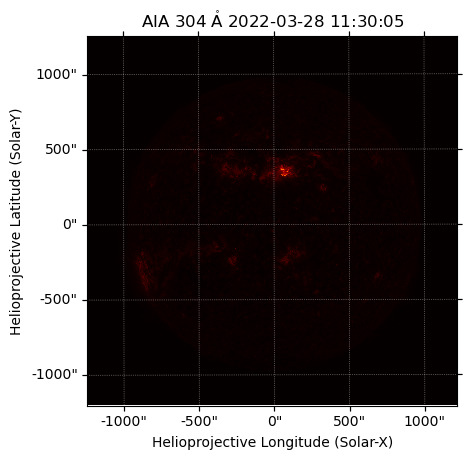

In [18]:
m_aia.plot()

This "automagically" creates a figure and an axis (with a projection based on the WCS of the map) and plots our map on that axis, with a colormap and normalization tailored for the specific map source.
All of this visualization is built on top of `matplotlib` and the `WCSAxes` capabilities provided by `astropy` that we saw demoed earlier today.
However, as you can see, the resulting default colorbar is not particularly useful.

Because all of this plotting capability is built on top of `matplotlib`, we can easily customize the various components of our plot.

<CoordinatesMap with 2 world coordinates:

  index aliases    type   unit wrap format_unit visible
  ----- ------- --------- ---- ---- ----------- -------
      0     lon longitude  deg  180         deg     yes
      1     lat  latitude  deg None         deg     yes

>

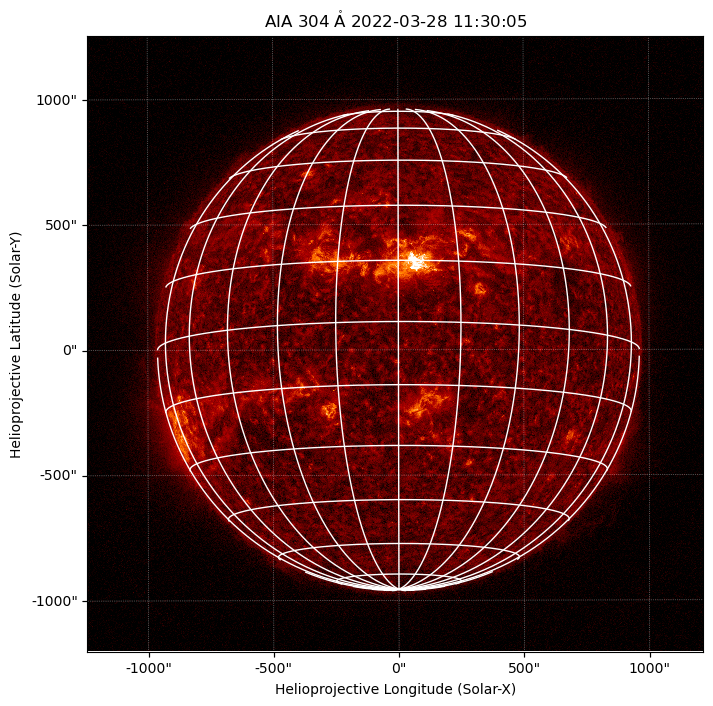

In [19]:
plt.figure(figsize=(8,8))
m_aia.plot(vmin=0,vmax=5e2)
m_aia.draw_grid(lw=1, alpha=1)

We can explictly create the axis and add the projection for the map if we want more fine-grained control over labels and titles.
We can also easily adjust the limits on our colorbar using the `clip_interval` key.

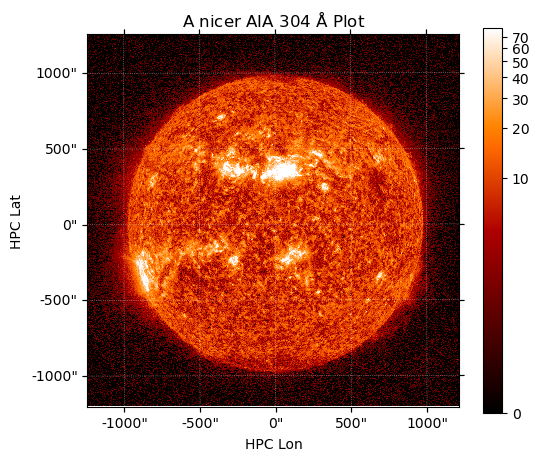

In [20]:
fig = plt.figure(figsize=(6,5))
ax = fig.add_subplot(111, projection=m_aia)
im = m_aia.plot(axes=ax, clip_interval=(25,99.6)*u.percent)
ax.set_title(r'A nicer AIA 304 $\mathrm{\AA}$ Plot')
ax.coords[0].set_axislabel('HPC Lon')
ax.coords[1].set_axislabel('HPC Lat')
fig.colorbar(im)

Or specify a new normalization altogether.

In [21]:
norm = ImageNormalize(vmin=0, vmax=200, stretch=LogStretch())

<div class="alert alert-block alert-warning">
    <h3><u>EXERCISE:</u> <br><br>How would I change the colormap for the above plot?</h3>
</div>

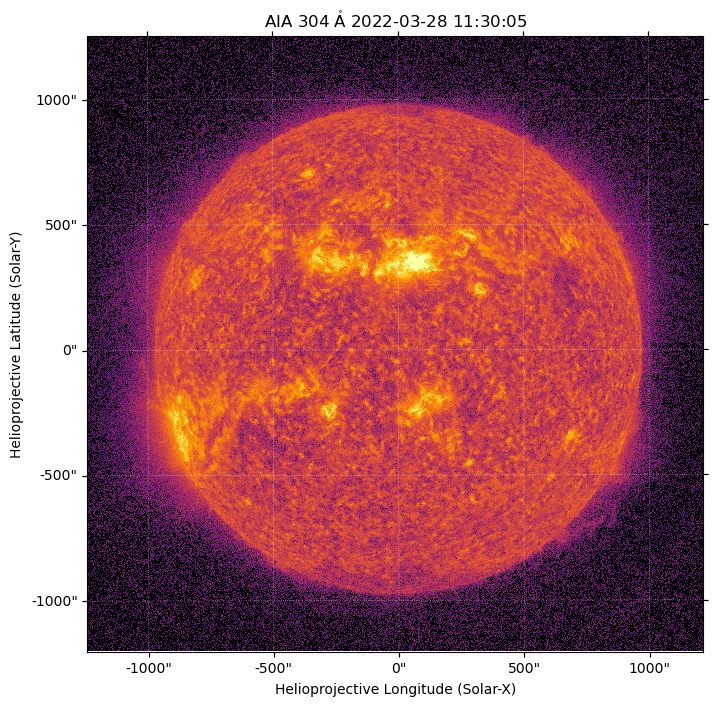

In [22]:
# INSTRUCTOR BLOCK
plt.figure(figsize=(8,8))
m_aia.plot(norm=norm, cmap='inferno')

Using `matplotlib` combined with `WCSAxes`, we can build more complex, publication-quality visualizations.

(**NOTE:** It is not necessary to fully understand every intricacy of the plotting code below during the course of the tutorial. This is merely to show how `Map.plot` can be be used to make more complex plots.)

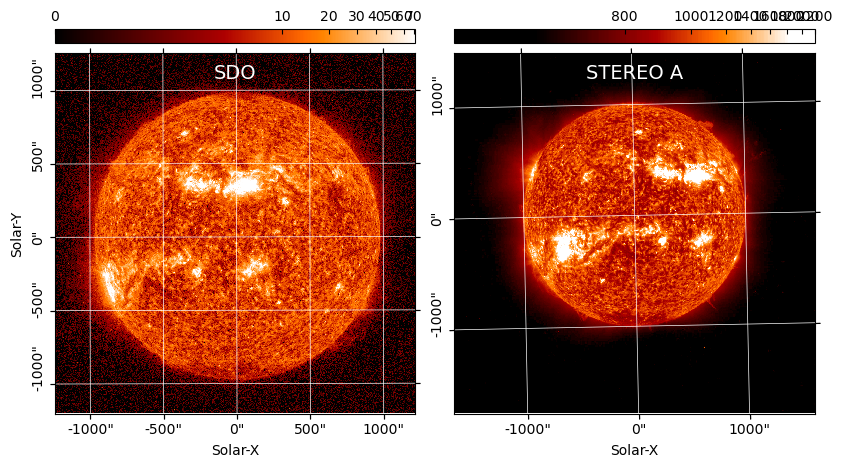

In [23]:
fig = plt.figure(figsize=(15,5))

for i, m in enumerate([m_aia, m_stereo]):
    # Create the axis with the appropriate projection
    ax = fig.add_subplot(1,3,i+1,projection=m)
    
    # Add the plot to the axis
    im = m.plot(axes=ax, annotate=False, clip_interval=(25,99.5)*u.percent)
    
    # Make the HPC grid lines visible
    ax.coords.grid(alpha=1, ls='-')
    
    # Adjust the labels and ticks
    if i > 0:
        ax.coords[1].set_auto_axislabel(False)
    else:
        ax.coords[1].set_axislabel('Solar-Y')
    ax.coords[0].set_axislabel('Solar-X')
    ax.coords[1].set_ticklabel(rotation=90,)
    
    # Put a label on each plot
    ax.text(m.data.shape[1]//2, m.data.shape[0]*.97, m.observatory,
            color='w',
            horizontalalignment='center',
            verticalalignment='top',
            fontsize=14)
    
    # Add a colorbar to the top of each plot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='4%', pad=0.1, axes_class=matplotlib.axes.Axes)
    fig.colorbar(im, cax=cax, orientation='horizontal')
    cax.xaxis.set_ticks_position("top")
    cax.xaxis.set_tick_params(direction='in')
    
plt.subplots_adjust(wspace=0.1)

<div class="alert alert-block alert-warning">
    <h3><u>EXERCISE:</u> <br><br>Do you know why the grid lines in the STEREO and EUI images appear tilted relative to the image?</h3>
</div>

In [24]:
# INSTRUCTOR BLOCK
# In the case of all three, the instrument is tilted (or "rolled") relative to solar north.
# In the case of STEREO-A and Solar Orbiter, this is more obvious because the roll is larger while
# in AIA it is relatively small.
# You can confirm this by looking at the rotation_matrix attribute of each map.
print('AIA')
print(m_aia.rotation_matrix)
print('STEREO')
print(m_stereo.rotation_matrix)

AIA
[[ 0.99999736  0.00229816]
 [-0.00229816  0.99999736]]
STEREO
[[ 0.99980408  0.01979354]
 [-0.01979354  0.99980408]]


### Animations with `MapSequence`

In addition, the `MapSequence` container provides a data container for holding multiple maps, such as in the case where you have a sequence of maps taken at successive times.
We can create `MapSequence` objects by passing in our list of files and the `sequence=True` keyword argument.

In [25]:
aia_seq = sunpy.map.Map(aia_files, sequence=True)

The `MapSequence` can be indexed to return the individual `Map` objects at each time step.

Observatory,SDO
Instrument,AIA 4
Detector,AIA
Measurement,304.0 Angstrom
Wavelength,304.0 Angstrom
Observation Date,2022-03-28 11:00:05
Exposure Time,2.902046 s
Dimension,[4096. 4096.] pix
Coordinate System,helioprojective
Scale,[0.600165 0.600165] arcsec / pix
Reference Pixel,[2067.137451 2005.397705] pix

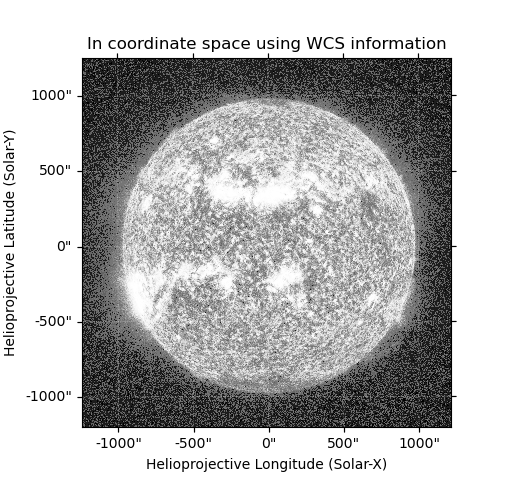
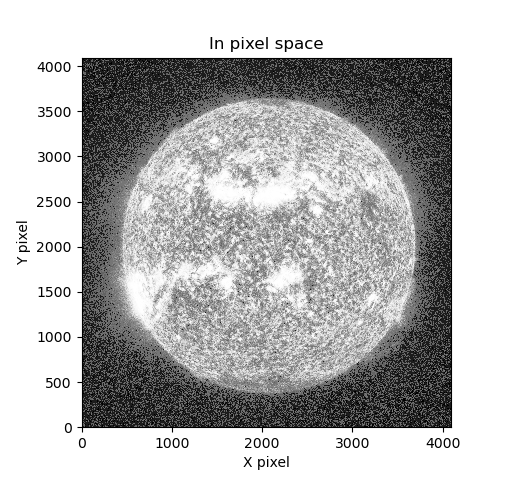
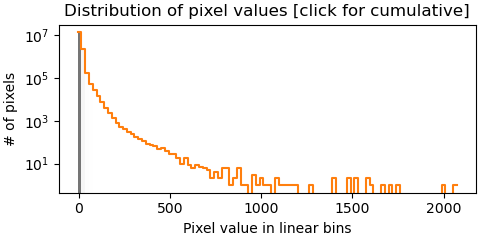
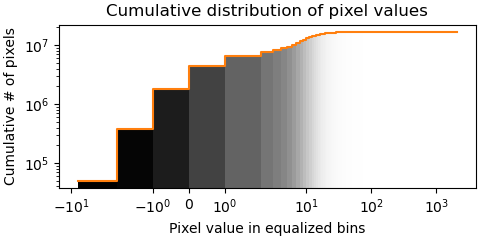

In [26]:
aia_seq[0]

One of the most useful features of a `MapSequence` is the ability to create coordinate-aware visualizations of our stack of `Map` objects.
To do this, we'll first create a a colormap normalization appropriate to the range of the data for every map in our stack.

We can do this with the STEREO data as well.

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


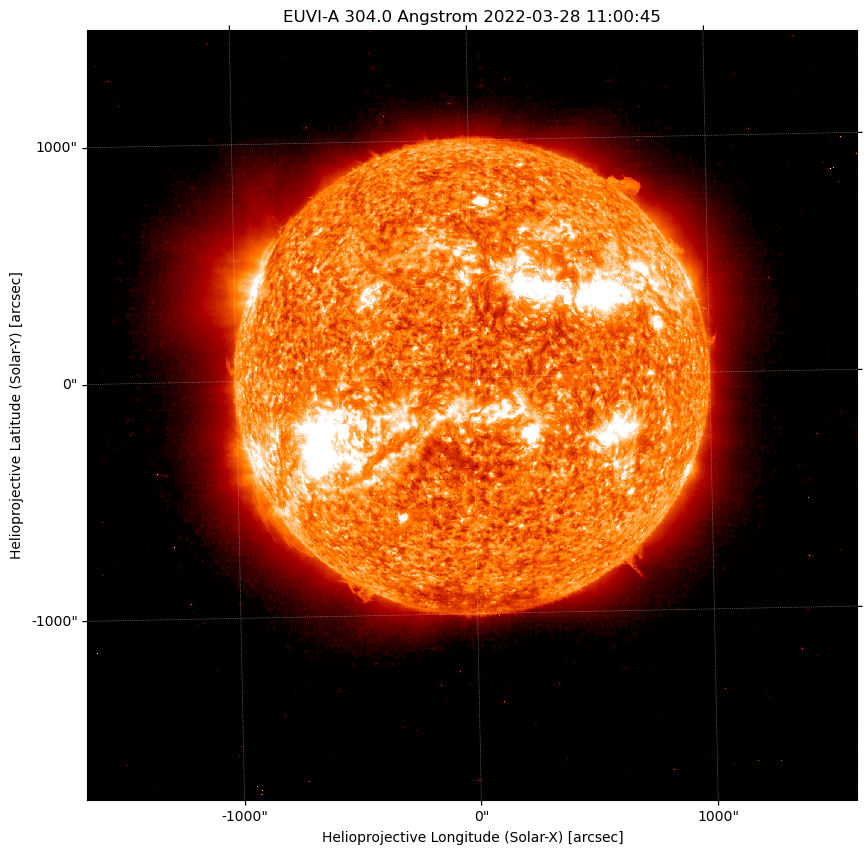

In [28]:
stereo_seq = sunpy.map.Map(stereo_files, sequence=True)
vmin, vmax = AsymmetricPercentileInterval(1,99.5).get_limits(stereo_seq.as_array())
norm=ImageNormalize(vmin=vmin, vmax=vmax, stretch=LogStretch())
plt.figure(figsize=(10,10))
stereo_ani = stereo_seq.plot(norm=norm)

In [29]:
HTML(stereo_ani.to_jshtml())

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Miss

Animation size has reached 21035015 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### `Map` and WCS

As we saw in the `astropy` tutorial, the world coordinate system (WCS) formalizes provides us a framework for transforming between pixel and world coordinates.

In [30]:
m_aia.wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'HPLN-TAN'  'HPLT-TAN'  
CRVAL : 0.0  0.0  
CRPIX : 2068.137451  2006.397705  
PC1_1 PC1_2  : 0.9999973592262  0.0022981602695876  
PC2_1 PC2_2  : -0.0022981602695876  0.9999973592262  
CDELT : 0.0001667125  0.0001667125  
NAXIS : 4096  4096

In [31]:
type(m_aia.wcs)

astropy.wcs.wcs.WCS

We can use the associated `pixel_to_world` and `world_to_pixel` functions to transform between the world and pixel coordinates of our images.

In [32]:
m_aia.wcs.pixel_to_world(0*u.pix, 0*u.pix)

<SkyCoord (Helioprojective: obstime=2022-03-28T11:30:05.150, rsun=696000.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2022-03-28T11:30:05.150, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (0.01124165, -6.72365584, 1.49322527e+11)>): (Tx, Ty) in arcsec
    (-1243.37120729, -1200.67980652)>

In [33]:
m_aia.bottom_left_coord

<SkyCoord (Helioprojective: obstime=2022-03-28T11:30:05.150, rsun=696000.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2022-03-28T11:30:05.150, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (0.01124165, -6.72365584, 1.49322527e+11)>): (Tx, Ty) in arcsec
    (-1243.37120729, -1200.67980652)>

The `bottom_left_coord` is the *center* of the pixel in the bottom left corner of our image.

In [34]:
m_aia.wcs.world_to_pixel(m_aia.bottom_left_coord)

(array(2.76941137e-10), array(5.00222086e-12))

Similarly, we can confirm that the `center` coordinate falls on the center of the map.

In [35]:
m_aia.center

<SkyCoord (Helioprojective: obstime=2022-03-28T11:30:05.150, rsun=696000.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2022-03-28T11:30:05.150, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (0.01124165, -6.72365584, 1.49322527e+11)>): (Tx, Ty) in arcsec
    (-11.72760899, 25.29534244)>

In [36]:
m_aia.wcs.world_to_pixel(m_aia.center)

(array(2047.5), array(2047.5))

In [37]:
m_aia.dimensions

PixelPair(x=<Quantity 4096. pix>, y=<Quantity 4096. pix>)

Note that the center of our AIA image does not align with the center of the Sun!

In [38]:
m_aia.wcs.world_to_pixel(SkyCoord(Tx=0*u.arcsec, Ty=0*u.arcsec, frame=m_aia.coordinate_frame))

(array(2067.137451), array(2005.397705))

<div class="alert alert-block alert-warning">
    <h3><u>EXERCISE:</u> <br><br>How would you find the position of the center of the STEREO map in the pixel coordinates of the AIA map?</h3>
</div>

In [41]:
# INSTRUCTOR BLOCK
m_aia.wcs.world_to_pixel(m_stereo.center)

(array(1215.81564098), array(1700.60012641))

### Basic Image Manipulation

There are several methods on the `Map` object that provide capabilities for doing basic image manipulation in combination with the coordinate information attached to each `Map`.

#### Rotate

The `.rotate` method applies a rotation in the image plane, i.e. about an axis out of the page. 
In the case where we do not specify an angle (or rotation matrix), the image will be rotated such that the world and pixel axes are aligned.
In the case of an image in helioprojective coordinate system, this means that solar north will be aligned with the y-like pixel axis of the image.

In [42]:
m_stereo_rot = m_stereo.rotate(missing=m_stereo.min())

By default, any missing values will be filled with "NaN". Here, we specify `missing` as the minimum intensity value of the map such.

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


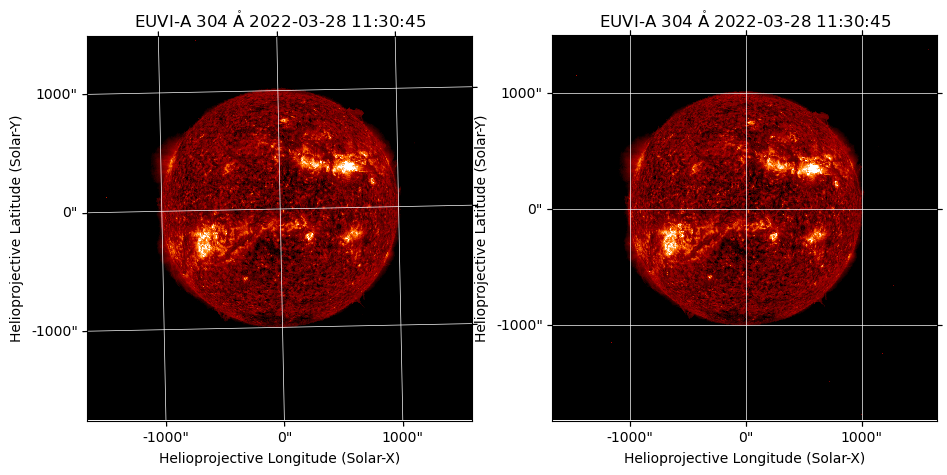

In [43]:
fig = plt.figure(figsize=(11,5))
ax = fig.add_subplot(121,projection=m_stereo)
m_stereo.plot(axes=ax, vmin=800, vmax=5e3)
ax.coords.grid(alpha=1, ls='-')
ax = fig.add_subplot(122,projection=m_stereo_rot)
m_stereo_rot.plot(axes=ax, vmin=800, vmax=5e3)
ax.coords.grid(alpha=1, ls='-')

This rotation is also reflected in the updated metadata of the rotated image.

In [44]:
m_stereo.rotation_matrix

array([[ 0.99980408,  0.01979354],
       [-0.01979354,  0.99980408]])

In [45]:
m_stereo_rot.rotation_matrix

array([[ 1.00000000e+00,  2.48407447e-18],
       [-2.31311758e-18,  1.00000000e+00]])

Additionally, one can also specify some arbitrary angle to rotate the image by.
Note that this angle is relative to the current orientation of the image.

In [46]:
m_stereo_rot30 = m_stereo.rotate(angle=30*u.deg, missing=m_stereo.min())

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


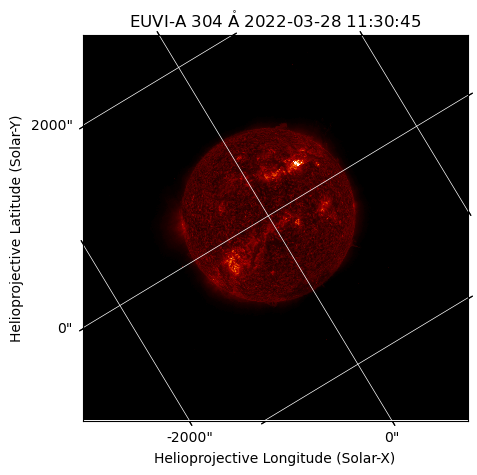

In [47]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111,projection=m_stereo_rot30)
m_stereo_rot30.plot(axes=ax)
ax.coords.grid(alpha=1, ls='-')

<div class="alert alert-block alert-warning">
    <h3><u>EXERCISE:</u> <br><br>How would you rotate the image such that there is exactly a 45 degree orientation between the world and pixel axes?</h3>
</div>

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


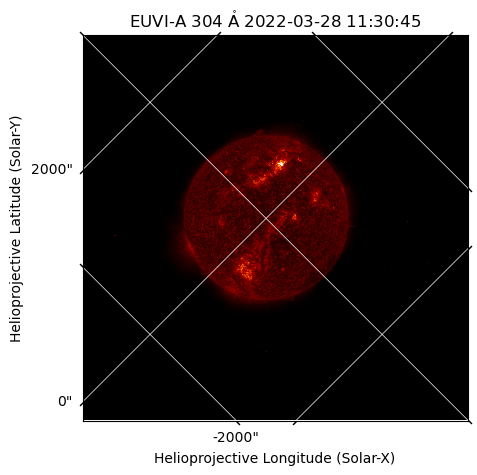

In [48]:
# INSTRUCTOR BLOCK
m_stereo_45 = m_stereo.rotate(missing=m_stereo.min()).rotate(angle=45*u.degree, missing=m_stereo.min())
plt.figure(figsize=(5,5))
m_stereo_45.plot()
ax = plt.gca()
ax.coords.grid(alpha=1, ls='-')

We'll apply a rotation to the AIA map as well.

In [49]:
m_aia_rot = m_aia.rotate(missing=m_aia.min())

#### Cropping Images with `submap`

We commonly want to pare down our full field-of-view to a particular region of interest.
With a map, we can do this using the `submap` method.

We can specify the region of our submap using world coordinates as specified by a `SkyCoord`.
We will specify these coordinates in Heliographic Stonyhurst (HGS) coordinates.
From the animation of the STEREO data above, we can identify approximately where the CME was launched from and crop our image around that region.

In [50]:
bottom_left = SkyCoord(lon=-20*u.deg, lat=-5*u.deg, radius=1*sunpy.sun.constants.radius,
                       frame='heliographic_stonyhurst', obstime=m_aia.date)
top_right = SkyCoord(lon=30*u.deg, lat=35*u.deg, radius=1*sunpy.sun.constants.radius,
                     frame='heliographic_stonyhurst', obstime=m_aia.date)

In [51]:
m_stereo_cropped = m_stereo.submap(bottom_left, top_right=top_right)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


Observatory,STEREO A
Instrument,SECCHI
Detector,EUVI
Measurement,304.0 Angstrom
Wavelength,304.0 Angstrom
Observation Date,2022-03-28 11:30:45
Exposure Time,4.00208 s
Dimension,[449. 431.] pix
Coordinate System,helioprojective
Scale,[1.58777404 1.58777404] arcsec / pix
Reference Pixel,[-109.38 7.74] pix

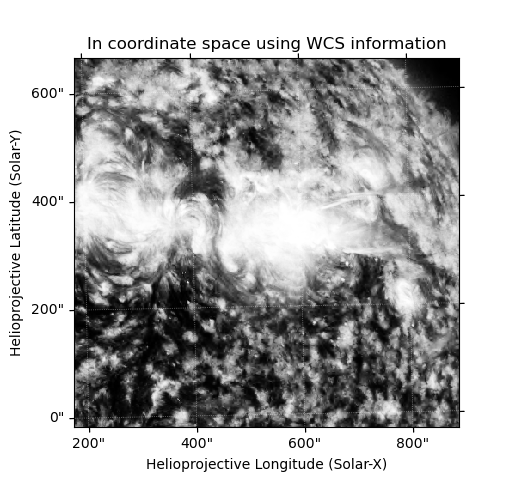
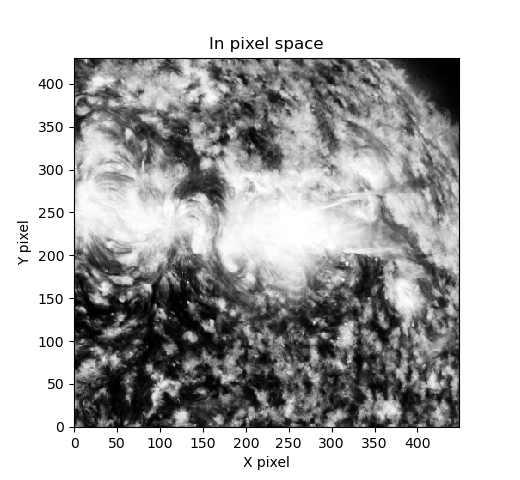
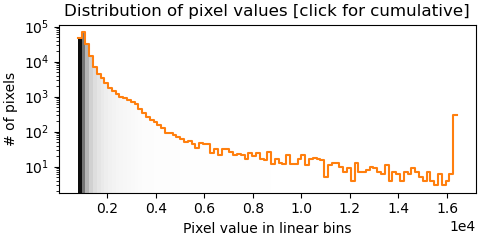
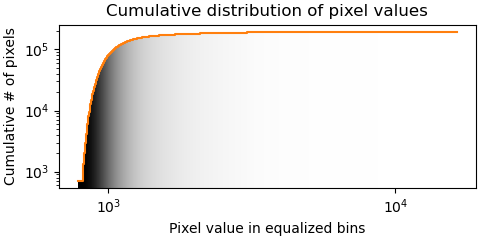

In [52]:
m_stereo_cropped

<div class="alert alert-block alert-warning">
    <h3><u>EXERCISE:</u> <br><br>The coordinates for our cutout can also be specified in pixel coordinates. Find the corners of our cutout in pixel coordinates and then create the same submap using those pixel coordinates.
</h3>
</div>

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


Observatory,STEREO A
Instrument,SECCHI
Detector,EUVI
Measurement,304.0 Angstrom
Wavelength,304.0 Angstrom
Observation Date,2022-03-28 11:30:45
Exposure Time,4.00208 s
Dimension,[449. 431.] pix
Coordinate System,helioprojective
Scale,[1.58777404 1.58777404] arcsec / pix
Reference Pixel,[-109.38 7.74] pix

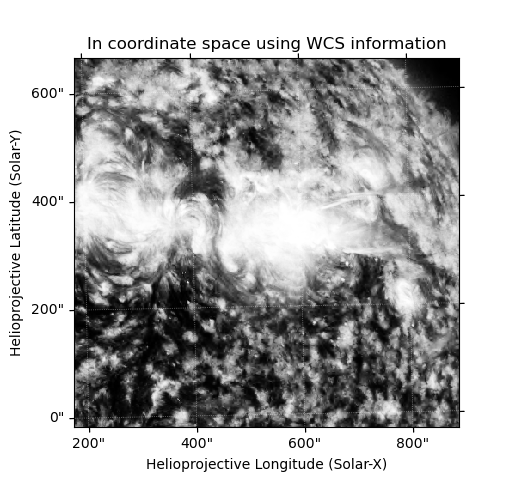
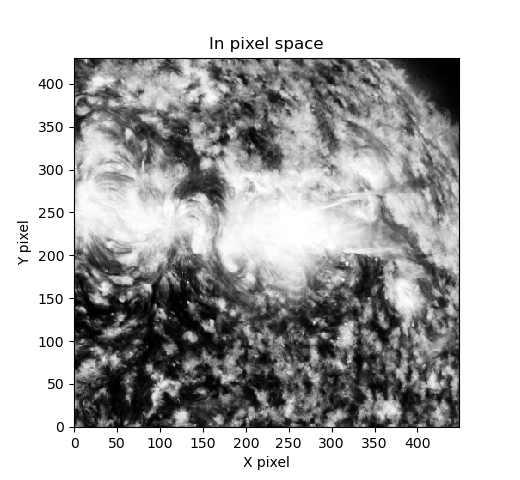
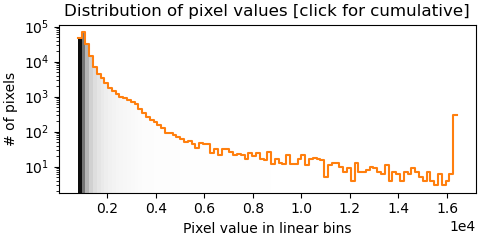
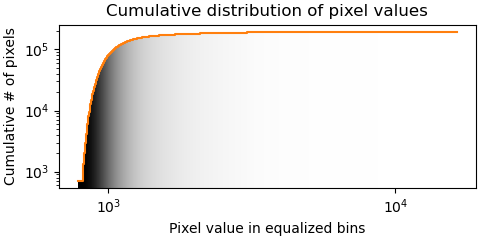

In [53]:
# INSTRUCTOR BLOCK
bl_pix = m_stereo.wcs.world_to_pixel(m_stereo_cropped.bottom_left_coord)
tr_pix = m_stereo.wcs.world_to_pixel(m_stereo_cropped.top_right_coord)
m_stereo.submap(bl_pix*u.pixel, top_right=tr_pix*u.pixel)

We can use those exact same coordinates to create a cutout from our AIA map.

In [54]:
m_aia_cropped = m_aia.submap(bottom_left, top_right=top_right)

Observatory,SDO
Instrument,AIA 4
Detector,AIA
Measurement,304.0 Angstrom
Wavelength,304.0 Angstrom
Observation Date,2022-03-28 11:30:05
Exposure Time,2.90206 s
Dimension,[1350. 1035.] pix
Coordinate System,helioprojective
Scale,[0.600165 0.600165] arcsec / pix
Reference Pixel,[548.137451 -24.602295] pix

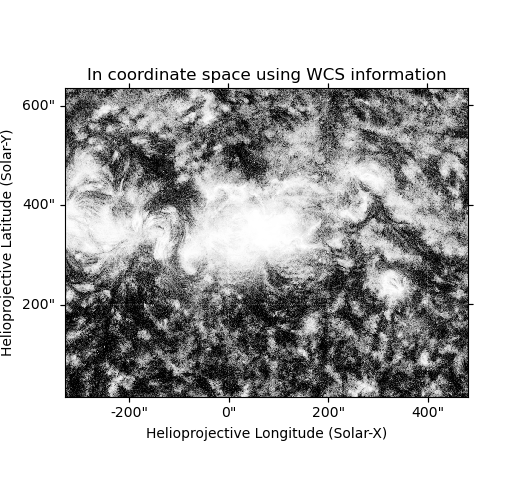
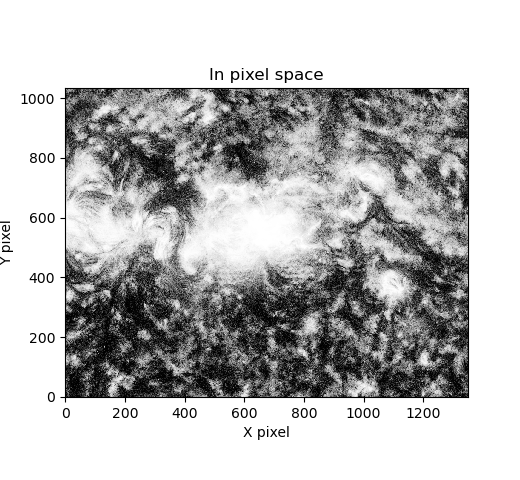
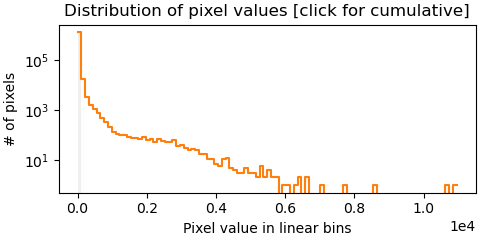
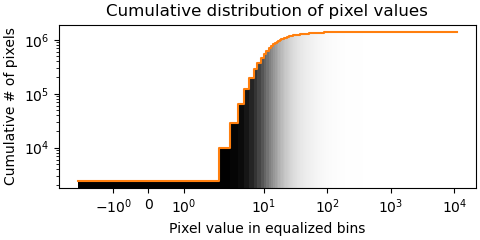

In [55]:
m_aia_cropped

## The `Timeseries` Data Structure

In addition to `Map` for 2D image data, `sunpy` also provides a container for tabular time series data through the `TimeSeries` class.
We can create a `TimeSeries` object in a very similar manner to how we create a `Map` object.

Let's look at the corresponding GOES XRS data that we downloaded in the previous notebook.

In [56]:
goes_files = sorted(glob.glob('data/XRS/*.nc'))

In [57]:
ts = sunpy.timeseries.TimeSeries(goes_files)

/srv/conda/envs/notebook/lib/python3.10/site-packages/astropy/stats/histogram.py:193: RuntimeWarning: invalid value encountered in double_scalars
  Nbins = np.ceil((data.max() - data.min()) / dx)


<sunpy.timeseries.sources.goes.XRSTimeSeries object at 0x7f6fe04a6dd0>
SunPy TimeSeries
----------------
Observatory:		 GOES-17
Instrument:		 <a href=https://www.swpc.noaa.gov/products/goes-x-ray-flux target="_blank">Unknown</a>
Channel(s):		 xrsa<br>xrsb<br>xrsa_quality<br>xrsb_quality<br>xrsa_primary_chan<br>xrsb_primary_chan
Start Date:		 2022-03-28 00:00:00
End Date:		 2022-03-28 23:59:59
Center Date:		 2022-03-28 11:59:59
Resolution:		 1.0 s
Samples per Channel:		 86400
Data Range(s):		 xrsa                8.78E-06<br>xrsb                4.10E-05<br>xrsa_quality        6.70E+01<br>xrsb_quality        6.70E+01<br>xrsa_primary_chan   0.00E+00<br>xrsb_primary_chan   0.00E+00
Units:		 W / m2<br>dimensionless
                                    xrsa      xrsb  xrsa_quality  \
2022-03-27 23:59:59.511091  4.832270e-08  0.000001             0   
2022-03-28 00:00:00.511087  5.866761e-08  0.000001             0   
2022-03-28 00:00:01.511085  5.398389e-08  0.000001             0   
2022-03-28 00:00:02.511080  4.365171e-08  0.000001             0   
2022-03-28 00:00:03.511076  5.115329e-08  0.000001             0   
...                                  ...       ...           ...   
2022-03-28 23:59:55.114166  1.657209e-07  0.000003             0   
2022-03-28 23:59:56.114156  1.610501e-07  0.000003             0   
2022-03-28 23:59:57.114153  1.779445e-07  0.000003             0   
2022-03-28 23:59:58.114152  1.694909e-07  0.000003             0   
2022-03-28 23:59:59.114147  1.676123e-07  0.000003             0   

                            xrsb_quality  xrsa_primary_chan  xrsb_primary_chan  
2022-03-27 23:59:59.511091             0                  1                  1  
2022-03-28 00:00:00.511087             0                  1                  1  
2022-03-28 00:00:01.511085             0                  1                  1  
2022-03-28 00:00:02.511080             0                  1                  1  
2022-03-28 00:00:03.511076             0                  1                  1  
...                                  ...                ...                ...  
2022-03-28 23:59:55.114166             0                  1                  1  
2022-03-28 23:59:56.114156             0                  1                  1  
2022-03-28 23:59:57.114153             0                  1                  1  
2022-03-28 23:59:58.114152             0                  1                  1  
2022-03-28 23:59:59.114147             0                  1                  1  

[86400 rows x 6 columns]
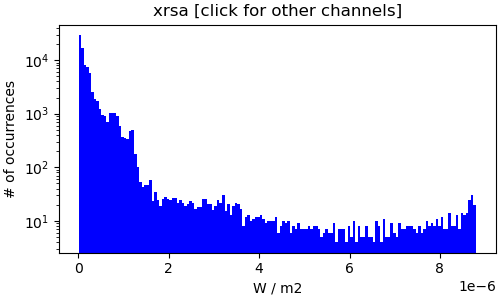
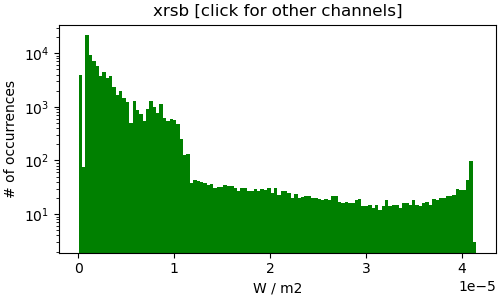
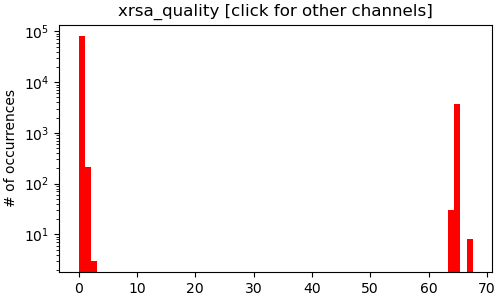
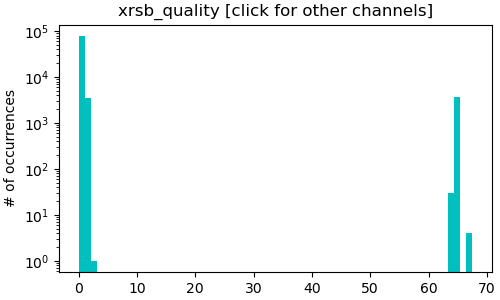
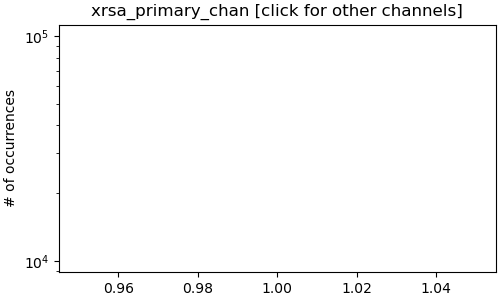
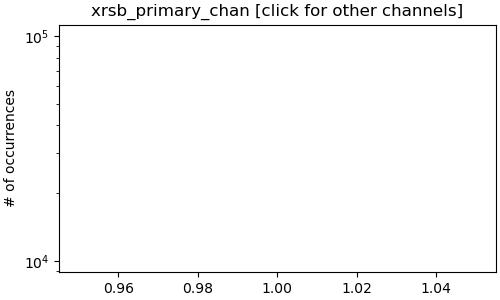
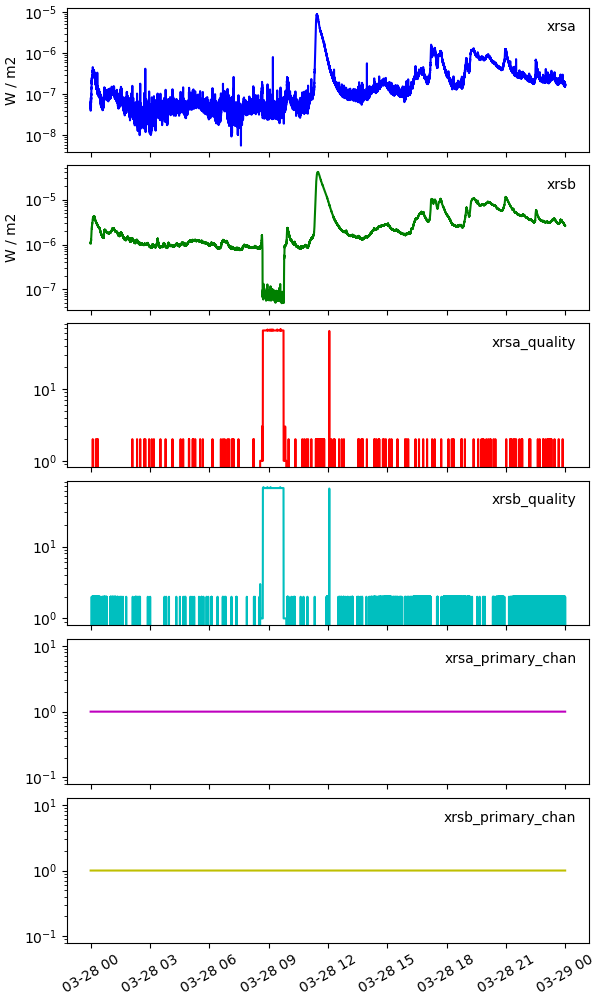
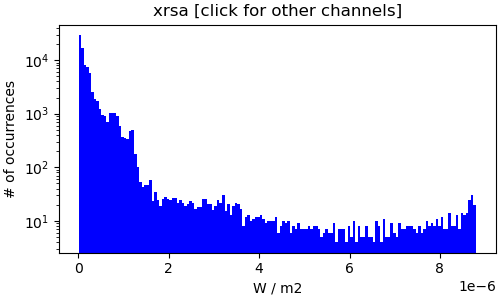

In [58]:
ts

As with `Map`, `TimeSeries` acts as a container for the data + metadata. We can access each component individually.

In [59]:
ts.meta

|-------------------------------------------------------------------------------------------------|
|TimeRange                  | Columns         | Meta                                              |
|-------------------------------------------------------------------------------------------------|
|2022-03-27T23:59:59.511091 | xrsa            | conventions: ACDD-1.3, Spase v2.2.6               |
|            to             | xrsb            | title: L2 XRS 1-s fluxes                          |
|2022-03-28T23:59:59.114147 | xrsa_quality    | summary: The X-Ray 1s flux product consists of hig|
|                           | xrsb_quality    | keywords: NumericalData.MeasurementType.Irradiance|
|                           | xrsa_primary_ch | keywords_vocabulary: SPASE: Space Physics Archive |
|                           | xrsb_primary_ch | naming_authority: gov.nesdis.noaa                 |
|                           |                 | history: See algorithm information.               |


The `TimeSeries` object can also be converted to other formats like an `astropy` `Table` object

In [60]:
ts.to_table()

date,xrsa,xrsb,xrsa_quality,xrsb_quality,xrsa_primary_chan,xrsb_primary_chan
,W / m2,W / m2,,,,
datetime64[ns],float32,float32,uint16,uint16,uint8,uint8
2022-03-27T23:59:59.511091000,4.83227e-08,1.0639529e-06,0,0,1,1
2022-03-28T00:00:00.511087000,5.8667606e-08,1.0764581e-06,0,0,1,1
2022-03-28T00:00:01.511085000,5.3983893e-08,1.0646678e-06,0,0,1,1
2022-03-28T00:00:02.511080000,4.365171e-08,1.066056e-06,0,0,1,1
2022-03-28T00:00:03.511076000,5.1153293e-08,1.0702107e-06,0,0,1,1
2022-03-28T00:00:04.511071000,6.149821e-08,1.0736918e-06,0,0,1,1
2022-03-28T00:00:05.511067000,4.553029e-08,1.0716093e-06,0,0,1,1
2022-03-28T00:00:06.511059000,5.397116e-08,1.0577158e-06,0,0,1,1


or a `pandas` `DataFrame`

In [61]:
ts.to_dataframe()

,xrsa,xrsb,xrsa_quality,xrsb_quality,xrsa_primary_chan,xrsb_primary_chan
2022-03-27 23:59:59.511091,4.832270e-08,0.000001,0,0,1,1
2022-03-28 00:00:00.511087,5.866761e-08,0.000001,0,0,1,1
2022-03-28 00:00:01.511085,5.398389e-08,0.000001,0,0,1,1
2022-03-28 00:00:02.511080,4.365171e-08,0.000001,0,0,1,1
2022-03-28 00:00:03.511076,5.115329e-08,0.000001,0,0,1,1
...,...,...,...,...,...,...
2022-03-28 23:59:55.114166,1.657209e-07,0.000003,0,0,1,1
2022-03-28 23:59:56.114156,1.610501e-07,0.000003,0,0,1,1
2022-03-28 23:59:57.114153,1.779445e-07,0.000003,0,0,1,1
2022-03-28 23:59:58.114152,1.694909e-07,0.000003,0,0,1,1


There are also a number of attributes on each `TimeSeries` derived from the data/metadata.

In [62]:
ts.columns

['xrsa',
 'xrsb',
 'xrsa_quality',
 'xrsb_quality',
 'xrsa_primary_chan',
 'xrsb_primary_chan']

In [63]:
ts.observatory

'GOES-17'

In [64]:
ts.source

'xrs'

In [65]:
ts.units

OrderedDict([('xrsa', Unit("W / m2")),
             ('xrsb', Unit("W / m2")),
             ('xrsa_quality', Unit(dimensionless)),
             ('xrsb_quality', Unit(dimensionless)),
             ('xrsa_primary_chan', Unit(dimensionless)),
             ('xrsb_primary_chan', Unit(dimensionless))])

### Slicing and Visualizing `TimeSeries`

Note that this intensity `TimeSeries` spans 24 h of observation time and recall that we are only interested in the ~3 h interval in which the CME is visible in the 304 channel.
We can truncate our timeseries around the times of interest.
To do this, we can actually use the `date` property on our first and last AIA map from our sequence.

In [69]:
ts_cme = ts.truncate(aia_seq[0].date.iso, aia_seq[-1].date.iso)

And then do a quicklook on our lightcurve.

/srv/conda/envs/notebook/lib/python3.10/site-packages/astropy/stats/histogram.py:193: RuntimeWarning: invalid value encountered in double_scalars
  Nbins = np.ceil((data.max() - data.min()) / dx)


<sunpy.timeseries.sources.goes.XRSTimeSeries object at 0x7f6fdff46d10>
SunPy TimeSeries
----------------
Observatory:		 GOES-17
Instrument:		 <a href=https://www.swpc.noaa.gov/products/goes-x-ray-flux target="_blank">Unknown</a>
Channel(s):		 xrsa<br>xrsb<br>xrsa_quality<br>xrsb_quality<br>xrsa_primary_chan<br>xrsb_primary_chan
Start Date:		 2022-03-28 11:00:05
End Date:		 2022-03-28 13:55:04
Center Date:		 2022-03-28 12:27:34
Resolution:		 1.0 s
Samples per Channel:		 10500
Data Range(s):		 xrsa                8.74E-06<br>xrsb                4.02E-05<br>xrsa_quality        6.40E+01<br>xrsb_quality        6.40E+01<br>xrsa_primary_chan   0.00E+00<br>xrsb_primary_chan   0.00E+00
Units:		 W / m2<br>dimensionless
                                    xrsa          xrsb  xrsa_quality  \
2022-03-28 11:00:05.329034  5.622896e-08  8.898164e-07             0   
2022-03-28 11:00:06.329035  5.247050e-08  8.794004e-07             0   
2022-03-28 11:00:07.329030  6.184433e-08  8.939645e-07             0   
2022-03-28 11:00:08.329025  5.247050e-08  8.988436e-07             0   
2022-03-28 11:00:09.329017  6.374589e-08  8.891220e-07             0   
...                                  ...           ...           ...   
2022-03-28 13:55:00.280718  1.107753e-07  1.492806e-06             0   
2022-03-28 13:55:01.280716  9.669663e-08  1.493510e-06             0   
2022-03-28 13:55:02.280709  1.070300e-07  1.500453e-06             0   
2022-03-28 13:55:03.280706  7.978753e-08  1.484485e-06             0   
2022-03-28 13:55:04.280702  9.669663e-08  1.494204e-06             0   

                            xrsb_quality  xrsa_primary_chan  xrsb_primary_chan  
2022-03-28 11:00:05.329034             0                  1                  1  
2022-03-28 11:00:06.329035             0                  1                  1  
2022-03-28 11:00:07.329030             0                  1                  1  
2022-03-28 11:00:08.329025             0                  1                  1  
2022-03-28 11:00:09.329017             0                  1                  1  
...                                  ...                ...                ...  
2022-03-28 13:55:00.280718             0                  1                  1  
2022-03-28 13:55:01.280716             0                  1                  1  
2022-03-28 13:55:02.280709             0                  1                  1  
2022-03-28 13:55:03.280706             0                  1                  1  
2022-03-28 13:55:04.280702             0                  1                  1  

[10500 rows x 6 columns]
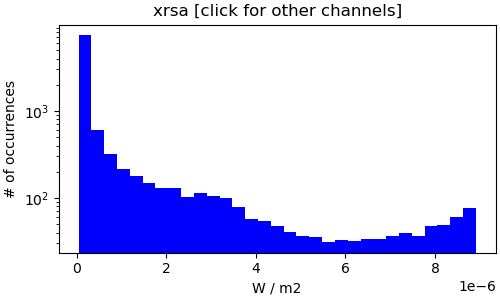
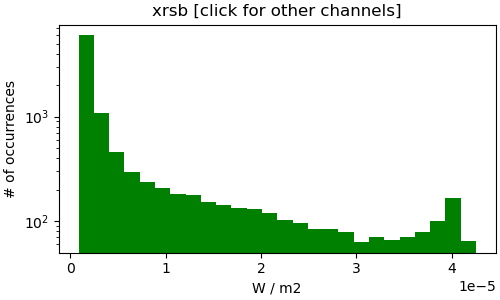
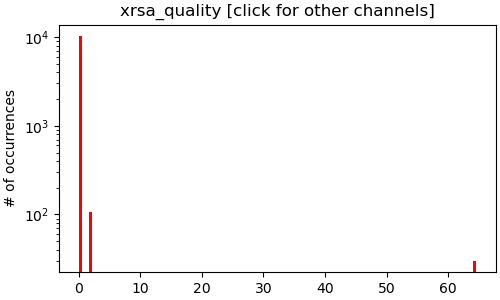
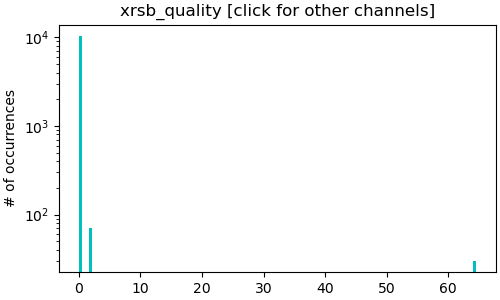
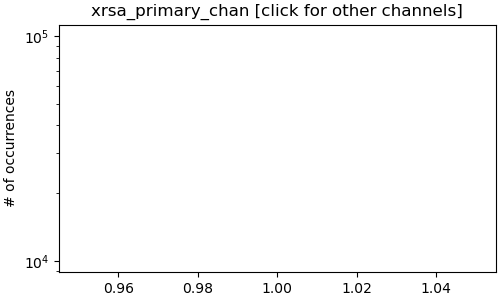
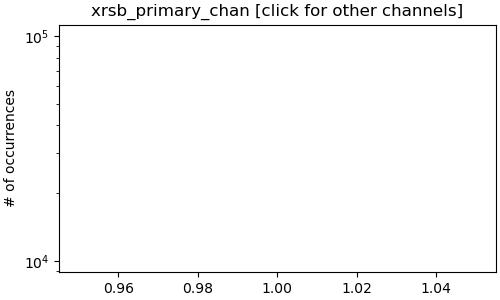
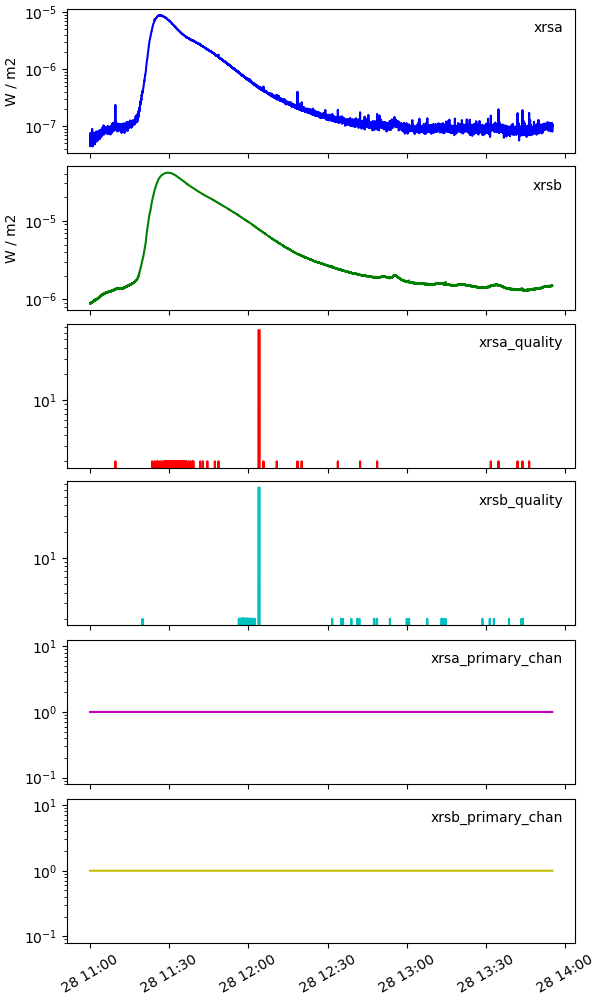
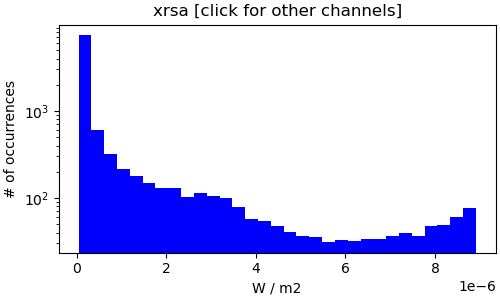

In [70]:
ts_cme